# MTH3302: Méthodes probabilistes et statistiques pour l'I.A.
## Projet

- Vincent Haney
- Félix Pelletier
- Charles-François St-Cyr (275354)
- Mikael Vaillant (2029994)


### 1. Librairies

In [905]:
using CSV, DataFrames, Distributions, Gadfly, MLBase, Random, Statistics, Colors, GLM, LinearAlgebra, Combinatorics, CategoricalArrays,Distances,NearestNeighbors

include("./library/main.jl");
include("./library/normalize.jl");
include("./library/missing-values.jl");

### 2. Visualisation des données

#### 2.1. Chargement des données pour la visualisation

In [906]:
base_data = CSV.read("./data/train_light.csv", DataFrame);

first(base_data, 5)

Row,ID,cut,color,clarity,depth,table,price,x,y,z
,Int64,String15?,String1,String7,Float64?,Float64,Int64,Float64,Float64?,Float64
1,1,missing,E,SI2,60.2,60.0,5340,6.46,6.5,3.9
2,2,Ideal,G,VVS2,62.7,57.0,1936,5.12,5.05,3.19
3,3,Premium,E,VVS1,62.0,59.0,1012,4.33,4.28,2.67
4,4,Ideal,G,VS2,61.7,57.0,720,4.41,4.38,2.71
5,5,missing,G,VS2,62.4,58.0,6301,6.41,6.48,4.02


#### 2.2. Visualisation de la taille

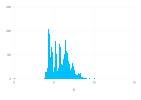

In [907]:
plot(base_data, x = :x, Geom.histogram)

#### 2.3. Comparaison des valeurs de tailles ($X$, $Y$, $Z$)

Nous examinons la relation entre $X$, $Y$ et $Z$. À première vue, ces données sont fortement corrélées. Ainsi, notre modèle ne devrait comporter qu'une seule de ces variables.

Nous remarquons également qu'il y a plusieurs points de données qui semblent aberrants.

In [908]:
plot(stack(base_data, [:y, :z]), x = :x, y = :value, color=:variable, Geom.point)

#### 2.4. Comparaison de $table$ et $depth$

On remarque que ces deux variables ne sont pas totalement indépendante. Les valeurs de $depth$ semblent diminuer un peu avec les valeurs de $table$ qui augmente. Cependant, cette corélation semble plutôt faible et il y a de l'information à en retirer de ces deux variables.

In [909]:
plot(base_data, x = :table, y = :depth)

#### 2.5. Comparaison de $X$, $Y$ et $Z$ par rapport au coût

On remarque que les valeurs de tailles sont corrélé avec le prix. On remarque que la taille augmente lorsque $price$ augmente.

On remarque aussi que $X$ et $Y$ pourrait être presque égaux pour chaque point de donné. C'est la tendence qui semble être observé lorsqu'on regarde les données numériques et selon le contexte.

On remarque aussi qu'il y a quelques données abberantes, dont des données de tailles égales à $0$.

In [910]:
plot(stack(base_data, [:x, :y, :z]), x = :price, y = :value, color = :variable)

#### 2.6. Comparaison de $table$ et $depth$ par rapport au coût

À première vue, ces variables ne semblent pas être les meilleures variables explicative.

In [911]:
plot(stack(base_data, [:table, :depth]), x = :price, y = :value, color = :variable)

### 3. Chargement des données

In [912]:
base_data = CSV.read("./data/train.csv", DataFrame);
base_test = CSV.read("./data/test.csv", DataFrame);

base_train, base_valid = partitionData(data, 0.75);

### 4. Détection de la colinéarité

Dans la section 2, nous avons remarqué qu'il y a très probablement de la colinéarité dans nos variables explicatives. Nous allons donc utiliser le VIF. Le VIF pour une variable $A$ est défini par :

$$
VIF_A = \frac{1}{1 - R^2_A}
$$

Où $R^2_A$ est le $R^2$ obtenu en faisant une régression linéaire de $A$ selon les autres variables explicatives. Une variable est considéré colinéaire si $VIF > 10$.

Tel qu'attendu, les variables $X$, $Y$ et $Z$ sont colinéaire. On remarque aussi que $depth$ et certaines $clarity$ sont aussi colinéaire.

In [913]:
data = deepcopy(base_data)

convertQualitativeToQuantitative(data, :color)
convertQualitativeToQuantitative(data, :cut)
convertQualitativeToQuantitative(data, :clarity)

color_names = getNamesForQuantitative(data, :color)
cut_names = getNamesForQuantitative(data, :cut)
clarity_names = getNamesForQuantitative(data, :clarity)

sort!(
    getAllVIF(data, ["x", "y", "z", "table", "depth", color_names..., cut_names..., clarity_names...]),
    :VIF,
    rev = true,
)

Row,Variable,VIF
,String,Float64
1,z,371.347
2,x,251.472
3,y,31.8934
4,clarity: SI1,13.9398
5,clarity: VS2,13.6598
6,depth,11.2673
7,clarity: SI2,10.9516
8,cut: Ideal,10.6833
9,clarity: VS1,10.2335


### 5. Valeurs manquantes

Vérifions dans les données quels sont les valeurs manquantes.

#### 5.1 Chargement des données

In [914]:
data = deepcopy(base_data);
test = deepcopy(base_test);

#### 5.2 Vérification des données

##### 5.2.1 Data

In [915]:
data_missing_counts = collect(count(ismissing, col) for col in eachcol(data))
data_zero_counts = (hcat([0,0,0,0]',hcat([count(x -> x < 0.05, skipmissing(data[:, col])) for col in [:depth,:table,:price,:x, :y, :z]]...)))'[:, 1]

DataFrame(Variables = names(data), DataMissing = data_missing_counts, DataZero = data_zero_counts)

Row,Variables,DataMissing,DataZero
,String,Int64,Int64
1,ID,0,0
2,cut,3806,0
3,color,0,0
4,clarity,0,0
5,depth,2201,13
6,table,0,0
7,price,0,0
8,x,0,4
9,y,2200,3


#### 5.2.2 Test

In [916]:

test_missing_counts = collect(count(ismissing, col) for col in eachcol(test))
test_zero_counts = (hcat([0,0,0,0]',hcat([count(x -> x < 0.05, skipmissing(test[:, col])) for col in [:depth,:table,:x, :y, :z]]...)))'[:, 1]

DataFrame(Variables = names(test), DataMissing = test_missing_counts, DataZero = test_zero_counts)

Row,Variables,DataMissing,DataZero
,String,Int64,Int64
1,ID,0,0
2,cut,1194,0
3,color,0,0
4,clarity,0,0
5,depth,800,5
6,table,0,0
7,x,0,4
8,y,800,4
9,z,0,5


### 6. **Méthode 1** : Régression linéaire simple

La première étape sera de faire une régression linéaire simple. Les données manquantes seront remplacé naïvement. Cette méthode ne soit pas idéale puisque qu'elle n'a pas une bonne estimation des valeurs manquantes. Cependant, cette méthode nous donne un $RMSE$ qu'on peut utiliser comme "*benchmark*" pour la suite.

#### 6.1 Chargement des données

In [917]:
data = deepcopy(base_data);
test = deepcopy(base_test);
train = deepcopy(base_train);
valid = deepcopy(base_valid);

#### 6.2 Traitement des valeurs manquantes

On remarque qu'il y a des valeurs manquantes dans les colonnes $cut$, $depth$ et $y$.

Tel qu'observé, on sait que les valeurs de $x$ sont très semblables aux valeurs de $y$, ainsi, nous allons remplacer toutes les valeurs manquantes de $y$ pas sa valeur de $x$.

Pour $cut$, nous allons remplacer les valeurs manquantes par le mode.

Pour $depth$, nous connaissons la formule pour l'obtenir, soit $2\times\frac{z}{x+y}$. Puisque nous allons remplacer les valeurs manquantes de $y$, alors il sera possible de recalculer la valeur.

In [918]:
replaceValuesNaive.([train, valid, test])

first(train, 5)

Row,ID,cut,color,clarity,depth,table,price,x,y,z
,Int64,String15?,String1,String7,Float64,Float64,Int64,Float64,Float64,Float64
1,2,Ideal,G,VVS2,62.7,57.0,1936,5.12,5.05,3.19
2,3,Premium,E,VVS1,62.0,59.0,1012,4.33,4.28,2.67
3,5,Ideal,G,VS2,62.4,58.0,6301,6.41,6.48,4.02
4,6,Premium,D,VVS2,61.5,60.0,925,4.36,4.42,2.7
5,7,Very Good,D,SI1,60.2,61.0,571,4.39,4.42,2.65


#### 6.3 Gestion de la colinéarité : Introduction d'une nouvelle variable

Nous savons que les variables $X$, $Y$ et $Z$ sont très colinéaire. Pour éviter ce problème, nous allons introduire la variable de volume. Puisqu'un élément important pour définir le prix d'un diamant est le nombre de carat (le poids), nous estimons que le volume est une bonne variable explicative. On défini donc

$$
volume = x \times y \times z
$$

In [919]:
train[!, :volume] = train.x .* train.y .* train.z
valid[!, :volume] = valid.x .* valid.y .* valid.z
test[!, :volume] = test.x .* test.y .* test.z;

#### 6.4 Définition du modèle

In [920]:
M = lm(@formula(price ~ volume + cut + clarity + color), train)

StatsModels.TableRegressionModel{LinearModel{GLM.LmResp{Vector{Float64}}, GLM.DensePredChol{Float64, CholeskyPivoted{Float64, Matrix{Float64}, Vector{Int64}}}}, Matrix{Float64}}

price ~ 1 + volume + cut + clarity + color

Coefficients:
───────────────────────────────────────────────────────────────────────────────
                     Coef.  Std. Error       t  Pr(>|t|)   Lower 95%  Upper 95%
───────────────────────────────────────────────────────────────────────────────
(Intercept)     -6230.53     96.1239    -64.82    <1e-99  -6418.93    -6042.12
volume             50.1574    0.128881  389.18    <1e-99     49.9048     50.41
cut: Good         428.615    65.1384      6.58    <1e-10    300.941     556.289
cut: Ideal        590.032    58.891      10.02    <1e-22    474.603     705.461
cut: Premium      572.521    59.9784      9.55    <1e-20    454.961     690.081
cut: Very Good    547.24     60.6134      9.03    <1e-18    428.435     666.044
clarity: IF      4855.24     95.7765     50.6

#### 6.5 Validation du modèle

Avec ce modèle, nous obtenons généralement un RMSE entre $1200$ et $1250$.

In [921]:
θ̂ = predict(M, valid)
rmse = RMSE(θ̂, valid.price)

println("RMSE: $(round(rmse))")

RMSE: 1266.0


### 7. **Méthode 2** : Régression linéaire avec estimation des valeurs manquantes par régression

À la première étape, nous avons utilisés des méthodes plus naïve pour estimer nos valeurs manquantes. Pour améliorer notre estimation, nous allons donc améliorer notre stratégie pour estimer les valeurs manquantes.

Cependant, nous garderons la même stratégie pour estimer $depth$.

#### 7.1 Chargement des données

In [922]:
data = deepcopy(base_data);
test = deepcopy(base_test);
train = deepcopy(base_train);
valid = deepcopy(base_valid);

#### 7.2 Transformation de la variable cut

Puisque la variable cut est qualitative, on ne peut pas utiliser un modèle linéaire pour l'estimer directement. Nous allons donc transformer la variable pour l'avoir de façon quantitative selon ce tableau.

| Valeur        | cut: Good | cut: Ideal | cut: Premium | cut: Very Good |
| ------------- | --------- | ---------- | ------------ | -------------- |
| $Fair$        | $0$       | $0$        | $0$          | $0$            |
| $Good$        | $1$       | $0$        | $0$          | $0$            |
| $Ideal$       | $0$       | $1$        | $0$          | $0$            |
| $Premium$     | $0$       | $0$        | $1$          | $0$            |
| $Very$ $Good$ | $0$       | $0$        | $0$          | $1$            |

In [923]:
convertQualitativeToQuantitative.([train, valid, test], :cut)

cut_names = getNamesForQuantitative(train, :cut)

first(train, 5)

Row,ID,cut,color,clarity,depth,table,price,x,y,z,cut: Good,cut: Ideal,cut: Premium,cut: Very Good
,Int64,String15?,String1,String7,Float64?,Float64,Int64,Float64,Float64?,Float64,Int64?,Int64?,Int64?,Int64?
1,2,Ideal,G,VVS2,62.7,57.0,1936,5.12,5.05,3.19,0,1,0,0
2,3,Premium,E,VVS1,62.0,59.0,1012,4.33,4.28,2.67,0,0,1,0
3,5,missing,G,VS2,62.4,58.0,6301,6.41,6.48,4.02,missing,missing,missing,missing
4,6,Premium,D,VVS2,61.5,60.0,925,4.36,4.42,2.7,0,0,1,0
5,7,Very Good,D,SI1,60.2,61.0,571,4.39,4.42,2.65,0,0,0,1


#### 7.3 Traitement des valeurs manquantes

Pour la variable $y$, nous définissons un modèle $y ~ x + table$, ensuite nous remplaçons les valeurs manquantes par la prédiction du modèle.

La variable $depth$ est traité de la même manière qu'à la section 6.2, soit que la valeur est recalculé avec $x$, $y$ et $z$.

Pour la variable $cut$, on défini $n - 1$ modèle pour chaque valeur. Ensuite, lorsque $cut$ est manquant, on remplace les valeurs quantitatives par l'estimation.

In [924]:
replaceValuesRegression.([train, valid, test])

first(train, 5)

Row,ID,cut,color,clarity,depth,table,price,x,y,z,cut: Good,cut: Ideal,cut: Premium,cut: Very Good
,Int64,String15?,String1,String7,Float64,Float64,Int64,Float64,Float64,Float64,Real,Real,Real,Real
1,2,Ideal,G,VVS2,62.7,57.0,1936,5.12,5.05,3.19,0,1,0,0
2,3,Premium,E,VVS1,62.0,59.0,1012,4.33,4.28,2.67,0,0,1,0
3,5,missing,G,VS2,62.4,58.0,6301,6.41,6.48,4.02,0.0687514,0.399477,0.312878,0.194252
4,6,Premium,D,VVS2,61.5,60.0,925,4.36,4.42,2.7,0,0,1,0
5,7,Very Good,D,SI1,60.2,61.0,571,4.39,4.42,2.65,0,0,0,1


#### 7.4 Gestion de la colinéarité : Introduction d'une nouvelle variable
Tout comme à l'étape précédente, nous allons introduire la variable :

$$
volume = x \times y \times z
$$

In [925]:
train[!, :volume] = train.x .* train.y .* train.z
valid[!, :volume] = valid.x .* valid.y .* valid.z
test[!, :volume] = test.x .* test.y .* test.z;

#### 7.5 Définition du modèle

In [926]:
M = lm(term(:price) ~ term(:volume) + term(:clarity) + term(:color) + sum(term.(cut_names)), train)

StatsModels.TableRegressionModel{LinearModel{GLM.LmResp{Vector{Float64}}, GLM.DensePredChol{Float64, CholeskyPivoted{Float64, Matrix{Float64}, Vector{Int64}}}}, Matrix{Float64}}

price ~ 1 + volume + clarity + color + cut: Good + cut: Ideal + cut: Premium + cut: Very Good

Coefficients:
────────────────────────────────────────────────────────────────────────────────
                     Coef.  Std. Error       t  Pr(>|t|)   Lower 95%   Upper 95%
────────────────────────────────────────────────────────────────────────────────
(Intercept)     -6212.59     95.7252    -64.90    <1e-99  -6400.21    -6024.96
volume             50.1587    0.129104  388.51    <1e-99     49.9056     50.4117
clarity: IF      4849.02     96.0475     50.49    <1e-99   4660.76     5037.27
clarity: SI1     3254.81     82.4393     39.48    <1e-99   3093.23     3416.39
clarity: SI2     2465.48     82.7678     29.79    <1e-99   2303.25     2627.71
clarity: VS1     4124.19     84.0469     49.07    <1e-99   3959.46     4

#### 7.6 Validation du modèle

Avec ce modèle, nous obtenons le même RMSE. La régression pour obtenir les données manquantes ne semblent pas apporter une différence significative.

In [927]:
θ̂ = predict(M, valid)
rmse = RMSE(θ̂, valid.price)

println("RMSE: $(round(rmse))")

RMSE: 1266.0


### 8. **Méthode 3** : Analyse en composantes principales

La méthode 2 n'a pas apporté d'amélioration par rapport à la méthode 1. Nous devons donc utiliser une différente méthode. Dans la méthode 1 nous avons introduit la variable $volume$ afin de tenter  de contourner le problème de colinéarité. Cependant, cette technique n'est pas idéale puisqu'elle enlève de l'information sur les valeurs individuelles de $x$, $y$ et $z$ et qu'elle ne prends pas en compte la colinéarité observé sur les variables $depth$ et $clarity$.

L'analyse en composante principale est une excellente méthode pour remédier à cette problématique.

#### 8.1. Chargement des données

In [928]:
data = deepcopy(base_data);
test = deepcopy(base_test);
train = deepcopy(base_train);
valid = deepcopy(base_valid);

#### 8.2. Transformation des valeurs qualitatives

In [929]:
convertQualitativeToQuantitative.([train, valid, test], :cut)
convertQualitativeToQuantitative.([train, valid, test], :color)
convertQualitativeToQuantitative.([train, valid, test], :clarity)

cut_names = getNamesForQuantitative(train, :cut)
color_names = getNamesForQuantitative(train, :color)
clarity_names = getNamesForQuantitative(train, :clarity)

first(train, 5)

Row,ID,cut,color,clarity,depth,table,price,x,y,z,cut: Good,cut: Ideal,cut: Premium,cut: Very Good,color: E,color: F,color: G,color: H,color: I,color: J,clarity: IF,clarity: SI1,clarity: SI2,clarity: VS1,clarity: VS2,clarity: VVS1,clarity: VVS2
,Int64,String15?,String1,String7,Float64?,Float64,Int64,Float64,Float64?,Float64,Int64?,Int64?,Int64?,Int64?,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64
1,2,Ideal,G,VVS2,62.7,57.0,1936,5.12,5.05,3.19,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1
2,3,Premium,E,VVS1,62.0,59.0,1012,4.33,4.28,2.67,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0
3,5,missing,G,VS2,62.4,58.0,6301,6.41,6.48,4.02,missing,missing,missing,missing,0,0,1,0,0,0,0,0,0,0,1,0,0
4,6,Premium,D,VVS2,61.5,60.0,925,4.36,4.42,2.7,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1
5,7,Very Good,D,SI1,60.2,61.0,571,4.39,4.42,2.65,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0


#### 8.3. Traitement des valeurs manquantes

Les valeurs manquantes sont traité de la même manière qu'à la section 7.3, soit en faisant une régression sur les variables manquantes.

In [930]:
replaceValuesRegression.([train, valid, test])

first(train, 5)

Row,ID,cut,color,clarity,depth,table,price,x,y,z,cut: Good,cut: Ideal,cut: Premium,cut: Very Good,color: E,color: F,color: G,color: H,color: I,color: J,clarity: IF,clarity: SI1,clarity: SI2,clarity: VS1,clarity: VS2,clarity: VVS1,clarity: VVS2
,Int64,String15?,String1,String7,Float64,Float64,Int64,Float64,Float64,Float64,Real,Real,Real,Real,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64
1,2,Ideal,G,VVS2,62.7,57.0,1936,5.12,5.05,3.19,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1
2,3,Premium,E,VVS1,62.0,59.0,1012,4.33,4.28,2.67,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0
3,5,missing,G,VS2,62.4,58.0,6301,6.41,6.48,4.02,0.0687514,0.399477,0.312878,0.194252,0,0,1,0,0,0,0,0,0,0,1,0,0
4,6,Premium,D,VVS2,61.5,60.0,925,4.36,4.42,2.7,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1
5,7,Very Good,D,SI1,60.2,61.0,571,4.39,4.42,2.65,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0


#### 8.3. Définition des matrices

$X$: Matrice de données d'entrainement

$Z$: Matrice normalisée de données d'entrainement

$y$: Vecteur des prédictions pour l'entrainement

In [931]:
cols = ["table", "depth", "x", "y", "z", cut_names..., color_names..., clarity_names...]

function standardize(df::DataFrame)
    for col in names(df)
        df[!, col] = (df[!, col] .- mean(df[!, col])) ./ std(df[!, col])
    end
    
    return df
end;

X = select(train, cols)

y = train.price
Z = hcat(ones(nrow(train)), Matrix(standardize(X)))

30341×23 Matrix{Float64}:
 1.0  -0.205033   0.523528  -0.547021  …  -0.543097  -0.270657   3.09021
 1.0   0.689791   0.147397  -1.2496       -0.543097   3.69459   -0.323592
 1.0   0.242379   0.362329   0.600235      1.84123   -0.270657  -0.323592
 1.0   1.1372    -0.121268  -1.22292      -0.543097  -0.270657   3.09021
 1.0   1.58462   -0.819797  -1.19624      -0.543097  -0.270657  -0.323592
 1.0   0.242379   0.416062   0.680276  …  -0.543097  -0.270657  -0.323592
 1.0   0.689791   1.43699   -0.386939     -0.543097  -0.270657  -0.323592
 1.0  -0.205033   0.308596   0.760317     -0.543097  -0.270657  -0.323592
 1.0   0.689791  -1.46459    0.137775      1.84123   -0.270657  -0.323592
 1.0   0.689791  -0.175001   2.22774       1.84123   -0.270657  -0.323592
 ⋮                                     ⋱   ⋮                    
 1.0   2.03203   -1.89446    1.81864      -0.543097  -0.270657  -0.323592
 1.0  -0.652445  -1.03473   -0.609275     -0.543097  -0.270657  -0.323592
 1.0  -0.652445   0.254

#### 8.4. Décomposition de la matrice $Z$

In [932]:
U, S, V = svd(Z);

#### 8.5. Variance expliquée par les composantes principales

Ici, l'objectif est de déterminer combien de variables sont nécessaire pour notre estimation. On remarque que pour avoir près de 100%, il est nécessaire d'utiliser 18 sur 23 variables explicatives.

Par soucis de simplicité, nous allons simplement garder les 23 variables puisqu'il n'y en a pas beaucoup de superflues.

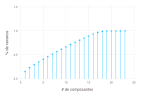

In [933]:
v = cumsum(S.^2) / sum(S.^2)

plot(x=1:length(v), y=v, Geom.point, Geom.hair,
    Guide.xlabel("# de composantes"), 
    Guide.ylabel("% de variance"))

#### 8.6. Calcul de la matrice des composantes principales

In [934]:
T = Z * V;

#### 8.7. Vérification de la colinéarité

Puisque l'objectif de cette technique est de ne pas avoir de multicolinéarité, alors on peut calculer les VIF pour s'en assurer. Ici, on voit que les VIF sont tous à $1$, on peut donc confirmer qu'il n'y a aucune colinéarité puisque les composantes sont orthogonales.

In [935]:
getAllVIF(DataFrame(T, :auto))

Row,Variable,VIF
,String,Float64
1,x1,1.0
2,x2,1.0
3,x3,1.0
4,x4,1.0
5,x5,1.0
6,x6,1.0
7,x7,1.0
8,x8,1.0
9,x9,1.0


#### 8.8. Régression sur l'analyse en composantes principales

Nous allons utiliser notre vecteur $y$ afin de créer notre estimation des facteur de régression.

In [936]:
η̂ = T \ y

β̂ = V * η̂;

#### 8.9. Validation du modèle

Avec cette méthode, le RMSE est plus gros qu'aux étapes précédentes. Elle n'est donc pas concluante.

In [937]:
Ỹ = hcat(ones(nrow(valid)), standardize(Matrix(select(valid, cols))))

ŷ = Ỹ * β̂
rmse = RMSE(ŷ, valid.price)

println("RMSE: $(round(rmse))")

RMSE: 1619.0


### 9. **Méthode 4** : KNN simple

Des 3 méthodes précédentes, nous n'avons pas réussi à avoir des meilleurs résultats qu'avec la régression linéaire simple. Nous avons donc décidé d'explorer une nouvelle avenue : KNN. Notre théorie est qu'il existe une quantité limité de type de diamant vendu et qu'ils se répètent. D'ailleur, lorsqu'on visualise la taille, on remarque qu'il y a des pics et qu'il semble donc y avoir des catégories de taille.

Ainsi, nous pensons que pour les diamants dans le fichier de test, nous allons être capable de trouver des diamants semblables et estimer son prix avec la moyenne.

#### 9.1. Chargement des données

In [938]:
data = deepcopy(base_data);
test = deepcopy(base_test);
train = deepcopy(base_train);
valid = deepcopy(base_valid);

#### 9.2. Transformation des valeurs qualitatives

In [939]:
convertQualitativeToQuantitative.([train, valid, test], :color)
convertQualitativeToQuantitative.([train, valid, test], :clarity)

color_names = getNamesForQuantitative(train, :color)
clarity_names = getNamesForQuantitative(train, :clarity)

first(train, 5)

Row,ID,cut,color,clarity,depth,table,price,x,y,z,color: E,color: F,color: G,color: H,color: I,color: J,clarity: IF,clarity: SI1,clarity: SI2,clarity: VS1,clarity: VS2,clarity: VVS1,clarity: VVS2
,Int64,String15?,String1,String7,Float64?,Float64,Int64,Float64,Float64?,Float64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64
1,2,Ideal,G,VVS2,62.7,57.0,1936,5.12,5.05,3.19,0,0,1,0,0,0,0,0,0,0,0,0,1
2,3,Premium,E,VVS1,62.0,59.0,1012,4.33,4.28,2.67,1,0,0,0,0,0,0,0,0,0,0,1,0
3,5,missing,G,VS2,62.4,58.0,6301,6.41,6.48,4.02,0,0,1,0,0,0,0,0,0,0,1,0,0
4,6,Premium,D,VVS2,61.5,60.0,925,4.36,4.42,2.7,0,0,0,0,0,0,0,0,0,0,0,0,1
5,7,Very Good,D,SI1,60.2,61.0,571,4.39,4.42,2.65,0,0,0,0,0,0,0,1,0,0,0,0,0


#### 9.3. Manipulation des données

Pour cette méthode, on ignore simplement les valeurs manquantes et nulles.

##### 9.3.1. Manipulations sur le fichier d'entrainement

In [940]:
# Retirer les entrées avec des valeurs missing ou nulle
train_no_empty = excludeMissingOrZero(deepcopy(train), [:x, :y, :z])
# Copie du prix
price_train = Matrix(select(train_no_empty, :price))
# Sélection de toutes les colonnes quantitatives
train_no_empty = select(train_no_empty, Not(["price","cut","ID","color","clarity","depth","table"]))
# Normalisation des données
train_no_empty = standardize(train_no_empty);

##### 9.3.2. Manipulations sur le fichier de validation

In [941]:
# Retirer les entrées avec des valeurs missing ou nulle
valid_no_empty = excludeMissingOrZero(deepcopy(valid), [:x, :y, :z])
# Enregistrement du prix actuel et du ID pour le calcul du RMSE 
valid_price_no_empty = select(valid_no_empty, [:ID, :price])
# Sélection de toutes les colonnes quantitatives
valid_no_empty = select(valid_no_empty, Not(["price","cut","ID","color","clarity","depth","table"]))
# Normalisation des données
valid_no_empty = standardize(valid_no_empty);

##### 9.3.3. Manipulations sur le fichier de test

In [942]:
test_no_empty = excludeMissingOrZero(deepcopy(test), [:x, :y, :z])
# Enregistrement du ID
test_prediction_no_empty = select(test_no_empty, [:ID])
# Sélection de toutes les colonnes quantitatives
test_no_empty = select(test_no_empty, Not(["cut","ID","color","clarity","depth","table"]))
# Normalisation des données
test_no_empty = standardize(test_no_empty);

#### 9.4. Définition des matrices

In [943]:
Mat_train = Matrix(train_no_empty)';
Mat_valid = Matrix(valid_no_empty)';
Mat_test = Matrix(test_no_empty)';

Mat_train

16×25887 adjoint(::Matrix{Float64}) with eltype Float64:
 -0.549506  -1.25431   -1.22754   …   0.529998   1.55597   -1.37029
 -0.594106  -1.2576    -1.13697       0.560553   1.50841   -1.29207
 -0.507245  -1.25684   -1.21359       0.703633   1.51088   -1.3145
 -0.467675   2.13816   -0.467675      2.13816   -0.467675  -0.467675
 -0.465526  -0.465526  -0.465526     -0.465526  -0.465526  -0.465526
  1.94072   -0.515254  -0.515254  …  -0.515254   1.94072   -0.515254
 -0.425658  -0.425658  -0.425658     -0.425658  -0.425658  -0.425658
 -0.334991  -0.334991  -0.334991     -0.334991  -0.334991   2.98504
 -0.235106  -0.235106  -0.235106     -0.235106  -0.235106  -0.235106
 -0.184475  -0.184475  -0.184475     -0.184475  -0.184475  -0.184475
 -0.559984  -0.559984  -0.559984  …  -0.559984   1.7857    -0.559984
 -0.454802  -0.454802  -0.454802      2.19867   -0.454802  -0.454802
 -0.425468  -0.425468  -0.425468     -0.425468  -0.425468  -0.425468
 -0.544498  -0.544498  -0.544498     -0.544498  -0.

#### 9.5. Définition de l'arbre KNN

In [944]:
# Génération de l'arbre de données et ajout de poids pour les différentes variables - À ajuster
weight = zeros(size(Mat_train,1))
weight[1:3] .= 1;
weight[4:9] .= 1;
weight[10:16] .= 1;

kdtree = KDTree(Mat_train, WeightedEuclidean(weight));

#### 9.6. Validation du modèle

In [945]:
# Nombre de plus proches voisins à utiliser - À ajuster
k = 7

# Algo knn pour valid
idxs, dists = knn(kdtree, Mat_valid, k, true)

prediction = [mean(price_train[ids]) for ids in idxs]
rmse = RMSE(prediction, valid_price_no_empty.price)

println("RMSE: $(round(rmse))")

RMSE: 633.0


### X. Analyse

#### X.1. Pistes ignorées

1. Nous avions pensé à regrouper certaines classes ensemble. Par exemple, pour la clarté, nous avions pensé, puisque certaines catégories sont colinéaire, que nous pourrions les regrouper. Cependant, lorsque nous avons décidé d'explorer l'analyse en composantes principales et KNN, nous nous sommes dit que ce n'étais pas nécessaire.

2. Lorsqu'on a fait un histograme avec la taille, nous avons remarqué qu'il semblait y avoir plusieurs pics de données. Nous avons estimé que c'est possible qu'il y aie des catégories de taille plutôt que des tailles spécifiques de diamant. Cependant, ça ne semblait pas nécessaire avec notre avenue final (KNN), donc nous n'avons pas continué avec cette idée. 